In [1]:
import os
from PIL import Image
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
import torch
import torchvision.transforms as transforms
import numpy as np
path = "D:\Casper\OTHER\Data\\aML\hw6\HW6_train\\5\\"
dir_list = os.listdir(path)

# print(f"Files and directories in '{path}':")

0	0.3671875	0.2109375	0.21875	0.21875
8	0.3359375	0.671875	0.21875	0.21875
8	0.71875	0.484375	0.21875	0.21875

(128, 128, 4)


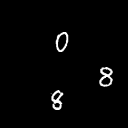

In [2]:
f = open(f"{path}/0000002.txt", "r")
print(f.read())
img = Image.open(f'{path}/0000002.png')
img = np.array(img)
print(img.shape)
img = Image.fromarray(img[:,:,2])
display(img)

In [3]:
img = Image.open(f'{path}/0000002.png')
r, g, b, trash = img.split()

r_array = np.array(r)
g_array = np.array(g)
b_array = np.array(b)

# Check if all channels have the same array values
are_channels_same = np.array_equal(r_array, g_array) and np.array_equal(g_array, b_array)
are_channels_same

True

In [4]:
from torch.utils.data import Dataset
import cv2
class HandwrittenDigitsDataset(Dataset):
    def __init__(self, images_folder, transform=None):
        self.images_folder = images_folder
        self.transform = transform
        self.image_files = [os.path.join(images_folder, f) for f in os.listdir(images_folder) if f.endswith('.png')]
        print(self.image_files)
        self.labels = None
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = self.image_files[idx]
        image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        
        label_path = img_path.replace('.png', '.txt')
        labels = []
        with open(label_path, 'r') as f:
            for line in f:
                label_data = line.strip().split('\t')
                digit_label = int(label_data[0])
                bbox_coords = [float(coord) for coord in label_data[1:]]
                labels.append([digit_label] + bbox_coords)
        if self.transform:
            image = self.transform(image)
        
        labels = np.array(labels, dtype=np.float32)
        return image, labels

transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((28, 28)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

train_dataset = HandwrittenDigitsDataset(path, transform)
# train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# test_dataset = HandwrittenDigitsDataset('HW6_test', transform=transform)
# test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

['D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000000.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000001.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000002.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000005.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000006.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000007.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000008.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000009.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000010.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000012.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000013.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000014.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000015.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000016.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000017.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6

In [5]:
print(train_dataset[2][0].shape)

torch.Size([1, 28, 28])


In [6]:
def custom_collate_fn(batch):
    images = []
    targets = []

    for image, labels in batch:
        images.append(image)
        if labels is not None:
            for label in labels:
                digit_label = label[0]
                bbox_coords = label[1:]
                targets.append([digit_label] + bbox_coords)

    images = torch.stack(images, 0)
    
    if len(targets) > 0:
        targets = torch.tensor(targets, dtype=torch.float32)
    else:
        targets = torch.empty((0, 5), dtype=torch.float32)

    return images, targets

In [7]:
import random
from torch.utils.data import DataLoader, Subset
def get_dataloaders(data_folder, transform, train_ratio, val_ratio, batch_size):
    # Create a single merged dataset
    train_dataset = HandwrittenDigitsDataset(data_folder, transform)
    val_dataset = HandwrittenDigitsDataset(data_folder, transform)
    test_dataset = HandwrittenDigitsDataset(data_folder, transform)

    # obtain training indices that will be used for validation
    num_train = len(test_dataset)
    indices = list(range(num_train))
    print("--------- INDEX checking ---------")
    print(f"Original: {indices[:5]}")
    random.shuffle(indices)
    print(f"Shuffled: {indices[:5]}")
    print("--------- INDEX shuffled ---------\n")

    split_train = int(np.floor(train_ratio * num_train))
    split_val = split_train + int(np.floor(val_ratio * (num_train-split_train)))
    train_idx, val_idx, test_idx = indices[0:split_train], indices[split_train:split_val], indices[split_val:]
    merge_dataset = Subset(train_dataset, train_idx)

    train_loader = DataLoader(merge_dataset, batch_size=batch_size, collate_fn=custom_collate_fn)
    val_loader = DataLoader(Subset(val_dataset, val_idx), batch_size=batch_size, collate_fn=custom_collate_fn)
    test_loader = DataLoader(Subset(test_dataset, test_idx), batch_size=batch_size, collate_fn=custom_collate_fn)
    
    # check dataset
    print(f"Total number of samples: {num_train} datapoints")
    print(f"Number of train samples: {len(train_loader)} batches/ {len(train_loader.dataset)} datapoints")
    print(f"Number of val samples: {len(val_loader)} batches/ {len(val_loader.dataset)} datapoints")
    print(f"Number of test samples: {len(test_loader)} batches/ {len(test_loader.dataset)} datapoints")
    print(f"Data Transform: {transform}")
    print(f"")
    
    dataloaders = {
        "train": train_loader,
        "val": val_loader,
        "test": test_loader,
    }
    return dataloaders

In [8]:
loaders = get_dataloaders(path, transform, 0.6, 0.5, 1)

['D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000000.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000001.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000002.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000005.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000006.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000007.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000008.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000009.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000010.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000012.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000013.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000014.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000015.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000016.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6_train\\5\\0000017.png', 'D:\\Casper\\OTHER\\Data\\aML\\hw6\\HW6

In [ ]:
for images, digit_labels, bbox_labels in loaders['train']:
    print(bbox_labels)
    break

In [ ]:
def count_parameters(model):
    total_num = 0
    for parameter in model.parameters():
        if parameter.requires_grad:
            total_num += parameter.numel() 
    return total_num

In [ ]:
from datetime import datetime

def pprint(output = '\n', show_time = False): # print and fprint at the same time
    filename = "hw6-MAY24.txt"
    print(output)
    with open(filename, 'a') as f:
        if show_time:
            f.write(datetime.now().strftime("[%Y-%m-%d %H:%M:%S] "))

        f.write(str(output))
        f.write('\n')
pprint("OFFICIAL START, Focus on the 3rd problem", True)

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class DigitBBoxModel(nn.Module):
    def __init__(self):
        super(DigitBBoxModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.fc1 = nn.Linear(128 * 3 * 3, 512)
        self.fc_digit = nn.Linear(512, 10)
        self.fc_bbox = nn.Linear(512, 4)
    
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = x.view(-1, 128 * 3 * 3)
        x = F.relu(self.fc1(x))
        digit_output = self.fc_digit(x)
        bbox_output = self.fc_bbox(x)
        return digit_output, bbox_output

model = DigitBBoxModel()

In [ ]:
import torch.optim as optim

criterion_digit = nn.CrossEntropyLoss()
criterion_bbox = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# def collate_fn(batch):
#     images = [item[0] for item in batch]
#     labels = [item[1] for item in batch]
    
#     images = torch.stack(images, 0)
    
#     digit_labels = []
#     bbox_labels = []
#     for label in labels:
#         for digit_bbox in label:
#             digit_labels.append(digit_bbox[0])
#             bbox_labels.append(digit_bbox[1:])
    
#     digit_labels = torch.tensor(digit_labels, dtype=torch.long)
#     bbox_labels = torch.tensor(bbox_labels, dtype=torch.float32)
    
#     return images, digit_labels, bbox_labels

for epoch in range(10):
    model.train()
    running_loss = 0.0
    for batch in loaders['train']:
        # images, digit_labels, bbox_labels = collate_fn(batch)
        images, bbox_labels = batch
        print(images.shape)
        print(bbox_labels.shape)
        
        # break
        images = images.to(device)
        digit_labels = digit_labels.to(device)
        bbox_labels = bbox_labels.to(device)

        optimizer.zero_grad()
        
        digit_output, bbox_output = model(images)
        print(digit_labels.shape)
        print(digit_output.shape)
        loss_digit = criterion_digit(digit_output, digit_labels)
        loss_bbox = criterion_bbox(bbox_output, bbox_labels)
        loss = loss_digit + loss_bbox
        
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    print(f'Epoch [{epoch+1}/10], Loss: {running_loss} ')

In [ ]:
import time
from torch import nn, optim
from tqdm import tqdm

def train(model_lists, model_name):
    model = model_lists[model_name]()
    if 'res' in model_name:
        num_features = model.fc.in_features
        model.fc = torch.nn.Linear(num_features, 10)
    elif 'swin' in model_name:
        num_features = model.head.in_features
        model.head = torch.nn.Linear(num_features, 10)


    pprint(f"Training model: {model_name}", True)
    model_parameters_amount = count_parameters(model)
    pprint(f"Total parameters: {model_parameters_amount:,}")

    model = model.cuda()
    criterion = nn.CrossEntropyLoss()
    lr= 0.005
    optimizer = optim.Adam(model.parameters(), lr=lr)
    # scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=2, gamma=0.2)
    pprint(f"Learning rate={lr}")
    iteration = 0
    epochs = 25
    start = time.time()
    phases = ['train', 'val']
    for epoch in range(epochs):
        for phase in phases:
            running_loss = 0.0
            correct_predictions = 0
            correct_top3_predictions = 0
            total_samples = 0
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode
            for images, labels in tqdm(loaders[phase]): # Iterate over data.
                images, labels = images.cuda(), labels.cuda()
                outputs = model(images)
                loss = criterion(outputs, labels)

                with torch.set_grad_enabled(phase == 'train'):
                    if phase == 'train': # backward + optimize only if in training phase
                        optimizer.zero_grad()
                        loss.backward()
                        optimizer.step()
                        # scheduler.step()
                running_loss += loss.item()
                _, predicted = torch.max(outputs, 1)
                correct_predictions += (predicted == labels).sum().item()
                
                _, top3_preds = outputs.topk(3, 1, True, True)
                correct_top3_predictions += sum([labels[i] in top3_preds[i] for i in range(labels.size(0))])

                total_samples += labels.size(0)
                iteration += 1

            avg_loss = running_loss / total_samples
            top1_accuracy = correct_predictions / total_samples * 100
            top3_accuracy = correct_top3_predictions / total_samples * 100
            pprint(f"Epoch [{epoch+1}/{epochs}], phase: {phase}, samples: {total_samples}, Loss: {avg_loss:.4f}, Top-1 Accuracy: {top1_accuracy:.2f}%, Top-3 Accuracy: {top3_accuracy:.2f}%")
    end = time.time()
    duration = end - start
    pprint(f"Elapsed time: {duration} seconds")
    model_scripted = torch.jit.script(model) # Export to TorchScript
    model_scripted.save(f'{model_name}.pt') # Save
    pprint(f"weight saved as: {model_name}.pt")

In [ ]:
import torchvision.models as models

# model_lists = {
#     'resnet18': lambda: models.resnet18(weights=models.ResNet18_Weights.DEFAULT),
#     'resnet50': lambda: models.resnet50(weights=models.ResNet50_Weights.DEFAULT),
#     'resnet101': lambda: models.resnet101(weights=models.ResNet101_Weights.DEFAULT),
#     'resnet152': lambda: models.resnet152(weights=models.ResNet152_Weights.DEFAULT),
#     'swin_v2_t': lambda: models.swin_v2_t(weights=models.Swin_V2_T_Weights.DEFAULT),
#     'swin_v2_s': lambda: models.swin_v2_s(weights=models.Swin_V2_S_Weights.DEFAULT),
#     'swin_v2_b': lambda: models.swin_v2_b(weights=models.Swin_V2_B_Weights.DEFAULT),
# }

# model_names = [
#     'resnet18',
#     'resnet50',
#     'resnet101',
#     'resnet152',
#     'swin_v2_t',
#     'swin_v2_s',
#     'swin_v2_b',
# ]
# for model_name in model_names:
#     train(model_lists, model_name)

In [ ]:
def majority_voting(output_list):
    stacked_outputs = torch.stack(output_list)
    avg_probs = torch.mean(stacked_outputs, dim=0)
    
    return avg_probs

In [ ]:
import time
from torch import nn, optim
from tqdm import tqdm

def eval(model_list):
    for model in model_list:
        model.cuda()
        model.eval()
    criterion = nn.CrossEntropyLoss()
    start = time.time()
    phases = ['val']
    num_class = 10
    for phase in phases:
        running_loss = 0.0
        correct_predictions = 0
        correct_top3_predictions = 0
        total_samples = 0
        confus = torch.zeros(num_class, num_class,dtype=int)            
        for images, labels in tqdm(loaders[phase]): # Iterate over data.
            images, labels = images.cuda(), labels.cuda()
            model_outputs = []
            for model in model_list:
                with torch.no_grad():
                    outputs = model(images)
                    model_outputs.append(outputs)
            vote_outputs = majority_voting(model_outputs)
            loss = criterion(vote_outputs, labels)
            running_loss += loss.item()
            _, predicted = torch.max(vote_outputs, 1)
            correct_predictions += (predicted == labels).sum().item()
            
            _, top3_preds = outputs.topk(3, 1, True, True)
            correct_top3_predictions += sum([labels[i] in top3_preds[i] for i in range(labels.size(0))])
            total_samples += labels.size(0)

            for ii in range(len(predicted)):
                confus[ labels.data[ii] ][ predicted[ii] ]+=1

        avg_loss = running_loss / total_samples
        top1_accuracy = correct_predictions / total_samples * 100
        top3_accuracy = correct_top3_predictions / total_samples * 100
        pprint(f"Phase: {phase}, samples: {total_samples}, Loss: {avg_loss:.4f}, Top-1 Accuracy: {top1_accuracy:.2f}%, Top-3 Accuracy: {top3_accuracy:.2f}%")
        for ii in range(num_class) :
            pprint(f"class {ii}:{confus.numpy()[ii]}")
        # pprint(confus)

    end = time.time()
    duration = end - start
    pprint(f"Elapsed time: {duration} seconds")

# HW2-1-1

In [ ]:
import torchvision.models as models
path = "D:\\Casper\\aML\\HW2\\"
path2 = "D:\\Casper\\aML\\HW2\\"
model_list = [
    torch.jit.load(f'{path}resnet152_hw1_99.87268470984435.pt'),
    torch.jit.load(f'{path}resnet152_hw1_99.7576902542199.pt'),
    torch.jit.load(f'{path}resnet152_hw1_99.8398291510945.pt'),
    torch.jit.load(f'{path}resnet152_hw1_99.79362602160253.pt'),
    torch.jit.load(f'{path}resnet152_hw1_99.81621421824305.pt'),
]

# model_name = [
#     'resnet152',
# ]
eval(model_list)

# HW2-1-2

In [ ]:

loaders = get_dataloaders(data_folder, transform, 1, 0.5, 1)
model2_1_2 = torch.jit.load(f'D:\\Casper\\aML\\HW2\\OneParaModel.pt')

def evaluation(model, data_loader):

    correct = 0
    total = 0

    print(f"")
    model.eval()
    with torch.no_grad():
        for inputs, labels in tqdm(data_loader):
            outputs = model(inputs)
            total += labels.size(0)
            correct += (outputs == labels).sum().item()
    accuracy = correct / total
    print(f"Total accuracy: {accuracy*100:.2f}%")
evaluation(model2_1_2, loaders['train'])
    

# HW2-1-3


In [ ]:
# def predict_folder_images(folder_path, model, output_csv_path):
#     # Ensure the model is in evaluation mode
#     model.eval()

#     # Define the transformation for the input images
#     transform = transforms.Compose([
#         # transforms.Resize((224, 224)),  # Resize images
#         transforms.ToTensor(),  # Convert to tensor
#         # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
#     ])
    
#     results = []

#     # Loop through all PNG files in the folder
#     for filename in os.listdir(folder_path):
#         if filename.endswith('.png'):
#             # Construct the full path to the image file
#             file_path = os.path.join(folder_path, filename)
            
#             # Load and transform the image
#             image = Image.open(file_path).convert('RGB')
#             image_tensor = transform(image).unsqueeze(0)  # Add batch dimension
                        
#             model_outputs = []
#             for model in model_list:
#                 with torch.no_grad():
#                     outputs = model(image_tensor)
#                     model_outputs.append(outputs)
#             vote_outputs = majority_voting(model_outputs)
#             _, predicted = torch.max(vote_outputs, 1)

#             # Save the filename and the predicted class
#             results.append([filename, predicted])

#     # Write results to a CSV file
#     with open(output_csv_path, 'w', newline='') as csvfile:
#         writer = csv.writer(csvfile)
#         writer.writerow(['image', 'class'])  # Write the header
#         writer.writerows(results)

# folder_path = 'D:\\Casper\\OTHER\\Data\\MNIST2\\HW2_MNIST_test'
# output_csv_path = 'predictions.csv'
# model = torch.jit.load(f'{path}resnet152_hw1_99.87268470984435.pt')
# predict_folder_images(folder_path, model, output_csv_path)